In [92]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
import pandas as pd
pd.set_option('display.max_columns', None)
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import numpy as np
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
import seaborn as sns
import networkx as nx
from sklearn.metrics.pairwise import euclidean_distances
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objs as go
from scipy.stats import kde
import plotly.express as px
from scipy.stats import gaussian_kde
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from bs4 import BeautifulSoup
import html5lib
import requests as rq

In [2]:
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id='581f080af45d42e1924261ae11d7de80',
                                                           client_secret='270800db73bc4b84bf8844270e8a4ff2'))

## Functions:

In [3]:
def artists_from_playlist(playlist_uri):
    playlist=sp.playlist_items(playlist_uri)
    artists=set()

    artists = {artist['name'] for item in playlist['items'] for artist in item['track']['artists']}

    return artists

def get_audio_features(artist):
    
    results=sp.search(q=f'artist:{artist}', limit=50)

    track_ids=[track['id'] for track in results['tracks']['items']]
    song_names=[track['name'] for track in results['tracks']['items']]

    while None in track_ids:
        none_position=track_ids.index(None)
        track_ids.remove(None)
        song_names.remove(song_names[none_position])
        
    while None in song_names:
        none_position=song_names.index(None)
        track_ids.remove(track_ids[none_position])
        song_names.remove(None)
    
    audio_features=sp.audio_features(track_ids) 
    
    while None in audio_features:
        none_position=audio_features.index(None)
        if none_position < len(song_names):
            song_names.remove(song_names[none_position])
        audio_features.remove(None)

    df=pd.DataFrame(audio_features)

    df['artist']=artist
    df['song name']=song_names

    col_song=df.pop('song name')
    df.insert(0, 'song name', col_song)

    col_artist=df.pop('artist')
    df.insert(0, 'artist', col_artist)
    
    if 'id' in df.columns:
        col_id=df.pop('id')
        df.insert(0, 'id', col_id)
        df=df.drop(['type','uri','track_href','analysis_url'],axis=1)
        return df
    

def get_data_from_list_playlists(lst_playlist):
    data=pd.DataFrame()
    for playlist_uri in lst_playlist:
        artists=artists_from_playlist(playlist_uri)
        df=pd.DataFrame()
        for artist in artists:
            df=get_audio_features(artist)
            data=pd.concat([data,df])
    return data    

def n_repeated_songs(df):
    return len(df['id']) - len(df['id'].unique())


# <center> ABOUT

From each list of playlists, we extract the name of the artists present in each playlist, and get the features for 50 songs from each artists. This data is stored in a dataframe where the first 3 columns are resplectivly the id of the track, the name of the artist and the name of the song. The next 13 columns are the features for each song. After this, we concat all dataframes in one with all infos. This all_df contains the data that's going to be used to make our clustering algorithm. We'll talk about that later.

# <center> Getting the data

## Test set

In [4]:
SS_Hits='https://open.spotify.com/playlist/37i9dQZF1DWVP71DYelp29?si=4619d91349044474'
SS_Covers='https://open.spotify.com/playlist/37i9dQZF1DWZqyWCBK6QTt?si=6be1e7934c4b4b93'
SS_Stripped='https://open.spotify.com/playlist/37i9dQZF1DXdFhiq9L31be?si=6fa3ea97468a4b75'
SS_Indie_Alternative='https://open.spotify.com/playlist/37i9dQZF1DWXMetQrUYhar?si=5ace0d14b9024a1c'
SS_Complete_Collection='https://open.spotify.com/playlist/37i9dQZF1DWTUm9HjVUKnL?si=ee12a5528d8843df'
SS_Holliday_Collection='https://open.spotify.com/playlist/37i9dQZF1DXdam5VrqMf3y?si=f182bdea75f3414c'
SS_Country='https://open.spotify.com/playlist/37i9dQZF1DXdXh4ecan7Hh?si=0aa87e91657c45f3'
SS_Pride='https://open.spotify.com/playlist/37i9dQZF1DXcaEXdyjLdxm?si=732e90b4888a4ff4'
lofi_beats='https://open.spotify.com/playlist/71d99pLh0TpbdIJESHAsDN?si=48d85d79871a44b1'
lofi_chill_beats='https://open.spotify.com/playlist/4x9OtLt7bsmvqktbF0Y0Gm?si=445b4f76fcf74113'
viva_latino='https://open.spotify.com/playlist/37i9dQZF1DX10zKzsJ2jva?si=b9fc5e93088645d0'
baila_reggeaton='https://open.spotify.com/playlist/37i9dQZF1DWY7IeIP1cdjF?si=93d7bbec687a45fd'

lst_playlist=[SS_Hits, SS_Covers, SS_Stripped, SS_Indie_Alternative, 
                  SS_Complete_Collection, SS_Holliday_Collection, SS_Country, SS_Pride,
                  lofi_beats,lofi_chill_beats,viva_latino,baila_reggeaton

]

In [5]:
test_df=get_data_from_list_playlists(lst_playlist)

In [6]:
check_test_df=test_df.copy()
check_test_df=check_test_df.drop_duplicates(subset=['id'])
check_test_df=check_test_df.drop(['id','artist','song name'],axis=1)

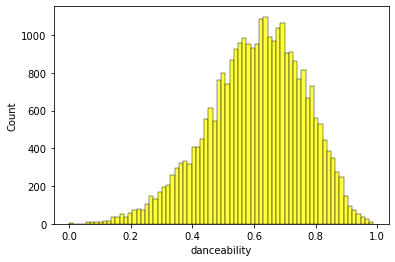

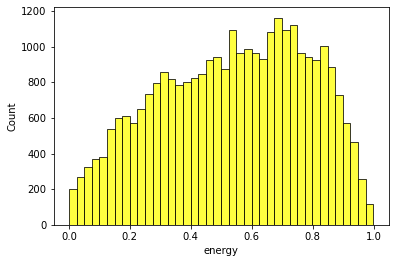

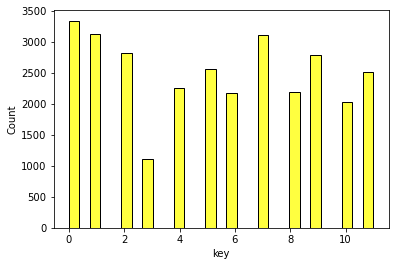

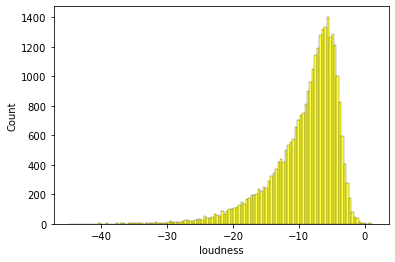

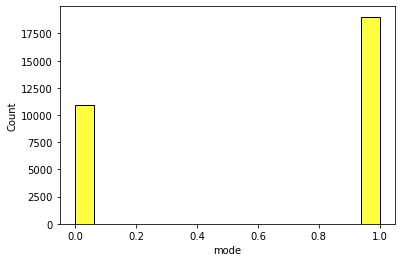

...

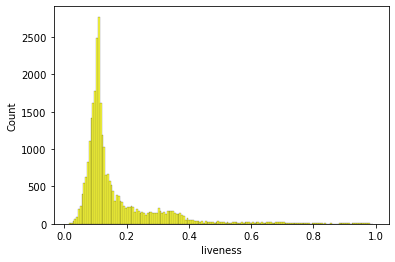

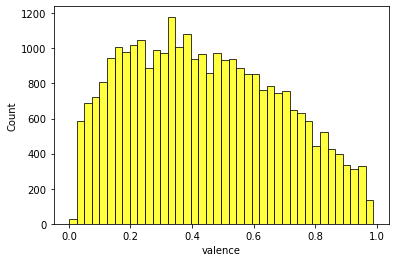

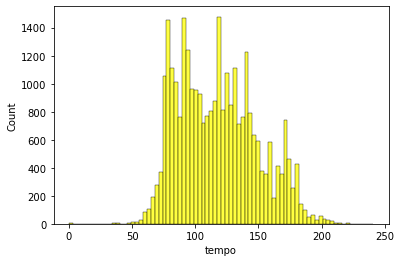

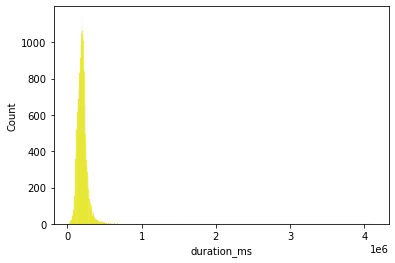

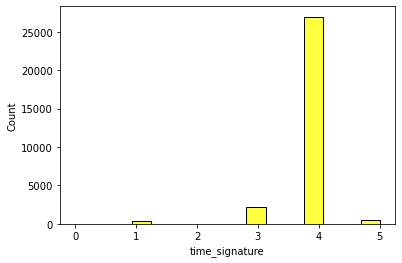

In [7]:
for column in check_test_df.columns:
    sns.histplot(check_test_df[column], kde=False,color='yellow')
    plt.show()

In [8]:
test=check_test_df.describe()[1:3]
test

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
mean,0.606888,0.536201,5.305637,-9.024940,0.635190,0.084474,0.393102,0.212528,0.169149,0.442149,117.916029,199191.149466,3.908406
std,0.155224,0.242999,3.571509,5.054075,0.481385,0.090024,0.336764,0.357821,0.133338,0.242592,31.364581,76622.723010,0.422699


# Genres

## Rock Playlists

In [9]:
rockthis='https://open.spotify.com/playlist/37i9dQZF1DXcF6B6QPhFDv?si=27d1dcae1a004730'
atl_now='https://open.spotify.com/playlist/37i9dQZF1DWVqJMsgEN0F4?si=5b76f803a4f74516'
all_new_rock='https://open.spotify.com/playlist/37i9dQZF1DWZryfp6NSvtz?si=f3e83c5c13234c30'
the_new_alt='https://open.spotify.com/playlist/37i9dQZF1DX82GYcclJ3Ug?si=e0fc74a414764eb7'
women_of_rock='https://open.spotify.com/playlist/37i9dQZF1DXd0ZFXhY0CRF?si=b9f9c4fb2562426c'
rock_hard='https://open.spotify.com/playlist/37i9dQZF1DWWJOmJ7nRx0C?si=a14ecca5ffb34fd5'
noisy='https://open.spotify.com/playlist/37i9dQZF1DX98f0uoU1Pcs?si=1cc3a457bcff44e6'
fresh_finds_rock='https://open.spotify.com/playlist/37i9dQZF1DX78toxP7mOaJ?si=52039451adc44b56'
legends_only='https://open.spotify.com/playlist/37i9dQZF1DX5a39zUmS7Hn?si=bbf1a311e94241e6'
alternative_noise='https://open.spotify.com/playlist/37i9dQZF1DWTBN71pVn2Ej?si=c510ea0fbabd4afd'
new_noise='https://open.spotify.com/playlist/37i9dQZF1DWT2jS7NwYPVI?si=6bb5ffacea774f54'
rock_frequency='https://open.spotify.com/playlist/37i9dQZF1DX14rbJEM3cke?si=79be9b358bac48ae'
the_locker='https://open.spotify.com/playlist/37i9dQZF1DWYmDNATMglFU?si=4206e064beb446d9'

rock_playlists=[rockthis,atl_now,all_new_rock,the_new_alt,women_of_rock,
                rock_hard,noisy,fresh_finds_rock,legends_only,alternative_noise,
                new_noise,rock_frequency,the_locker]

In [10]:
rock_df=get_data_from_list_playlists(rock_playlists)

In [11]:
check_rock_df=rock_df.copy()
check_rock_df=check_rock_df.drop_duplicates(subset=['id'])
check_rock_df=check_rock_df.drop(['id','artist','song name'],axis=1)

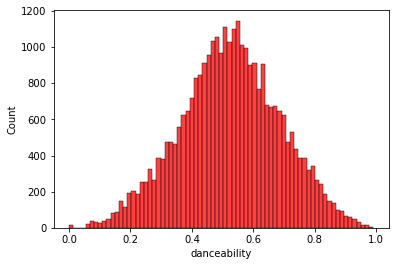

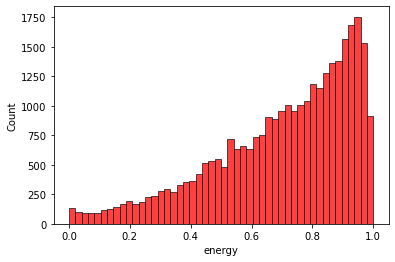

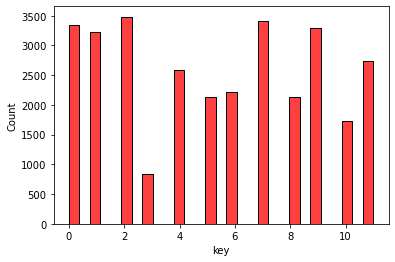

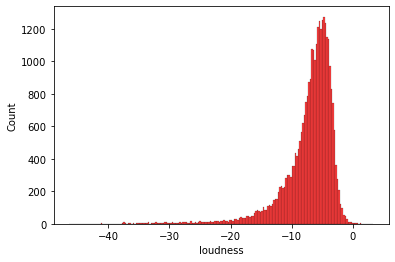

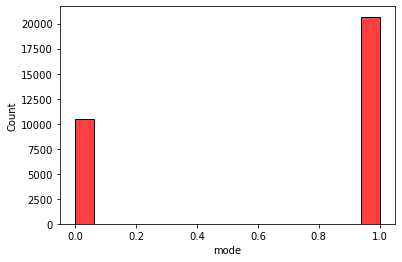

...

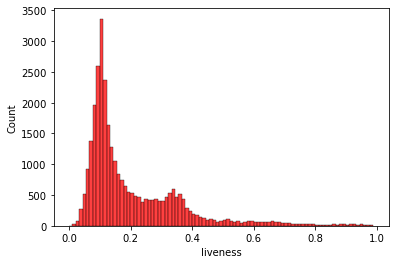

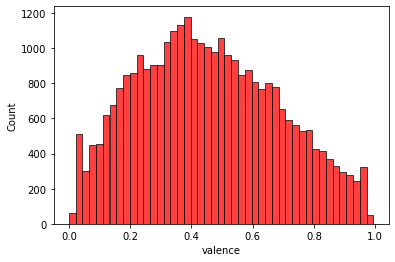

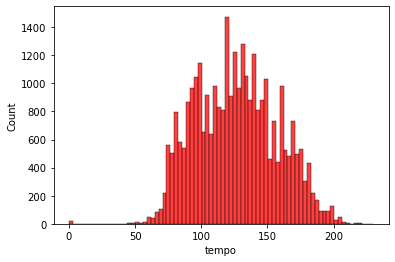

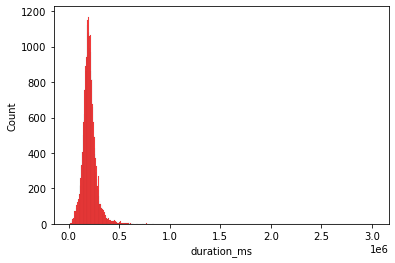

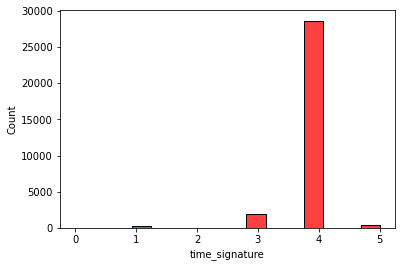

In [12]:
for column in check_rock_df.columns:
    sns.histplot(check_rock_df[column], kde=False,color='red')
    plt.show()

In [13]:
rock=check_rock_df.describe()[1:3]
rock

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
mean,0.524806,0.703217,5.302580,-7.223864,0.664654,0.082317,0.176677,0.123947,0.204652,0.453891,126.384933,208624.146969,3.927013
std,0.162017,0.227607,3.580341,4.308307,0.472119,0.088024,0.273304,0.269491,0.160571,0.229686,30.631364,79445.056354,0.368728


## Funk & Disco playlists

In [14]:
funk_soul_classics='https://open.spotify.com/playlist/37i9dQZF1DWWvhKV4FBciw?si=ca988ddf9dfd4d28'
global_groove='https://open.spotify.com/playlist/37i9dQZF1DWUS3jbm4YExP?si=56351100493946ae'
grooveria_gospel='https://open.spotify.com/playlist/37i9dQZF1DWYZ7fMlF5ORU?si=f895f4a7084f4b0b'
funk_outta_here='https://open.spotify.com/playlist/37i9dQZF1DX70TzPK5buVf?si=73339e8221bb4d8c'
brazilian_boogie='https://open.spotify.com/playlist/37i9dQZF1DWVBWFXlHC6s7?si=21516aa69a8641c6'
disco_hi_life='https://open.spotify.com/playlist/37i9dQZF1DXbS8bPVXXR2B?si=ae93fa5d70fb4b9c'
funky_jams='https://open.spotify.com/playlist/37i9dQZF1DX6drTZKzZwSo?si=f742974a4f27445c'
the_roller_rink='https://open.spotify.com/playlist/37i9dQZF1DWZXHVUlGM9Wp?si=dc786cd0cac04263'
queens_of_disco='https://open.spotify.com/playlist/37i9dQZF1DXdJyxIBq7Xdy?si=72fe069931de4e94'
future_funk='https://open.spotify.com/playlist/37i9dQZF1DXbjGYBfEmjR5?si=18b62e2970174e88'
nu_funk='https://open.spotify.com/playlist/37i9dQZF1DWZgauS5j6pMv?si=5a5887f7c17a47dd'
instrumental_funk='https://open.spotify.com/playlist/37i9dQZF1DX8f5qTGj8FYl?si=165d2ffcff8c42ff'
all_funked_up='https://open.spotify.com/playlist/37i9dQZF1DX4WgZiuR77Ef?si=219d6918b6eb4311'

funk_playlists=[funk_soul_classics,global_groove,grooveria_gospel,funk_outta_here,brazilian_boogie,
               disco_hi_life,funky_jams,the_roller_rink,queens_of_disco,future_funk,nu_funk,instrumental_funk,
               all_funked_up]

In [15]:
funk_df=get_data_from_list_playlists(funk_playlists)

In [16]:
check_funk_df=funk_df.copy()
check_funk_df=check_funk_df.drop_duplicates(subset=['id'])
check_funk_df=check_funk_df.drop(['id','artist','song name'],axis=1)

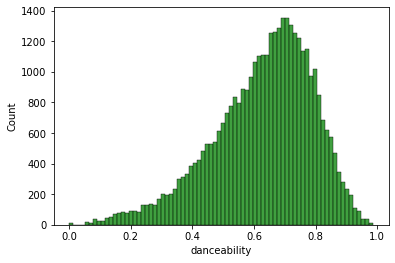

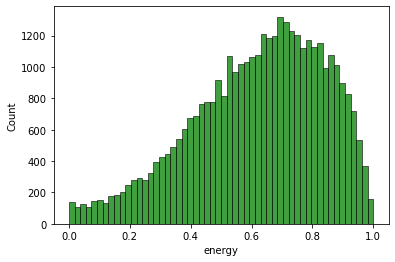

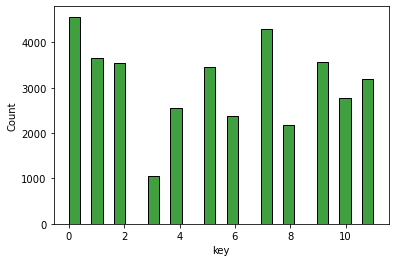

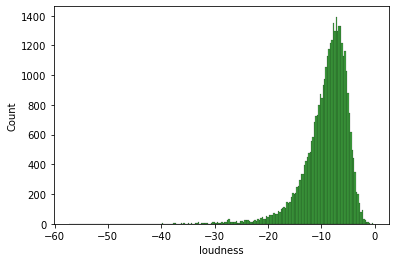

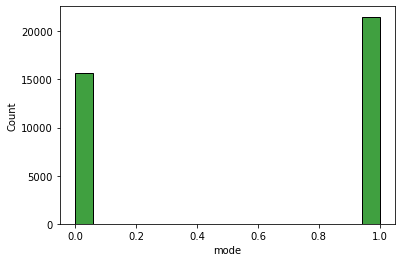

...

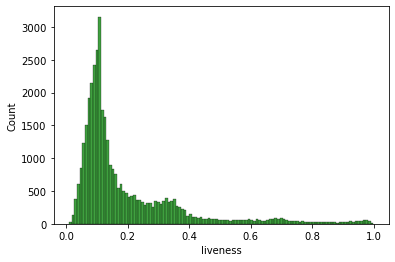

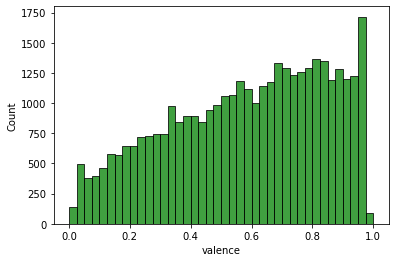

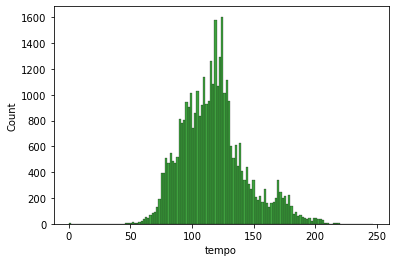

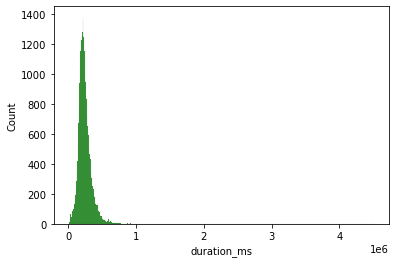

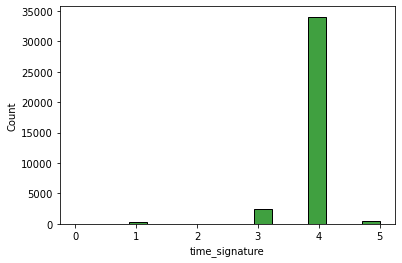

In [17]:
for column in check_funk_df.columns:
    sns.histplot(check_funk_df[column], kde=False,color='green')
    plt.show()

In [18]:
funk=check_funk_df.describe()[1:3]
funk

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
mean,0.630004,0.619800,5.325335,-9.101874,0.578277,0.090687,0.283556,0.219715,0.192777,0.582515,117.956925,243232.191380,3.925109
std,0.162582,0.216315,3.622019,4.241340,0.493841,0.108941,0.294237,0.341000,0.175700,0.258123,26.501294,111249.871672,0.365977


## Techno playlists

In [19]:
techno_bunker='https://open.spotify.com/playlist/37i9dQZF1DX6J5NfMJS675?si=fb91f394e3cf491c'
melodic_house_and_techno='https://open.spotify.com/playlist/4FNFDQwQhs0z6fFhY8hlVI?si=7b26d5ca3da0450f'
techno_house_2023_hits='https://open.spotify.com/playlist/2MSE9BQC2U1i3U4NNltxOw?si=51de85a9bf144b42'
techno_rave='https://open.spotify.com/playlist/48yJRrbHtz1DwDEQEZuohc?si=8549b4d7821e4b3f'
techno_workout='https://open.spotify.com/playlist/37i9dQZF1DX36TRAnIL92N?si=ca141a396d9d46f1'
techno_state='https://open.spotify.com/playlist/37i9dQZF1DX8ZMwsPgxIOs?si=ab2a9431989f46d5'
techNo='https://open.spotify.com/playlist/4IXbg9fg6FzhGr97NmTJQK?si=541af77665eb42f6'

techno_playlists=[techno_bunker,melodic_house_and_techno,techno_house_2023_hits,techno_rave,
                  techno_workout,techno_state,techNo]

In [20]:
techno_df=get_data_from_list_playlists(techno_playlists)

In [21]:
check_techno_df=techno_df.copy()
check_techno_df=check_techno_df.drop_duplicates(subset=['id'])
check_techno_df=check_techno_df.drop(['id','artist','song name'],axis=1)

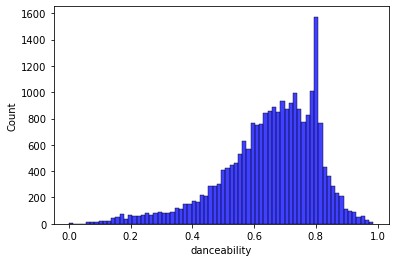

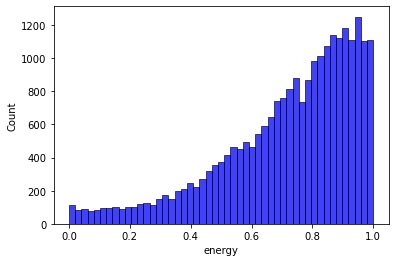

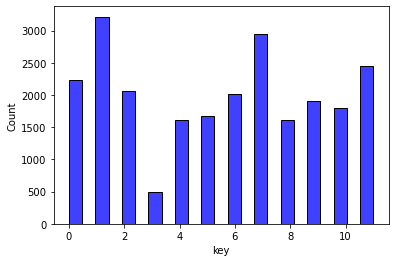

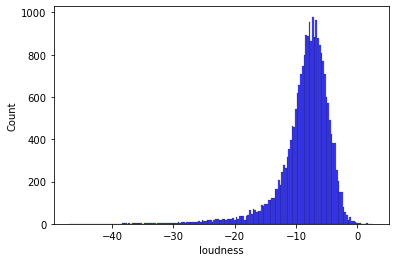

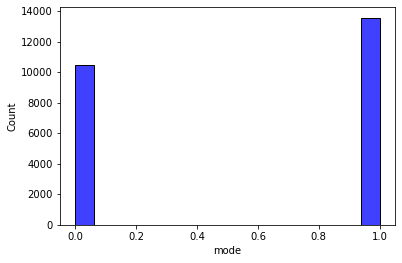

...

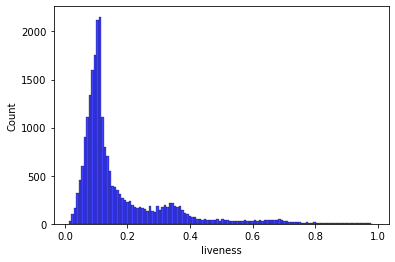

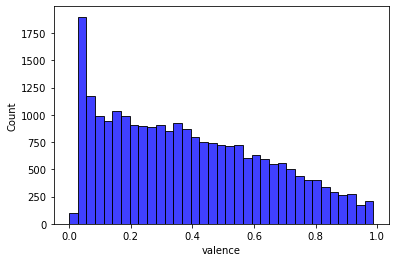

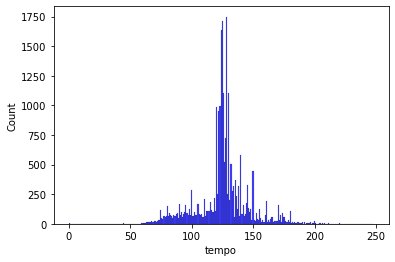

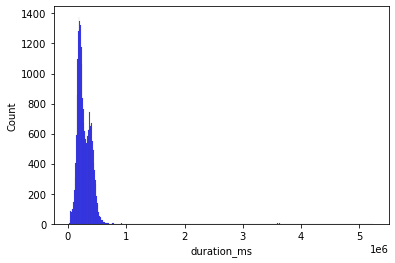

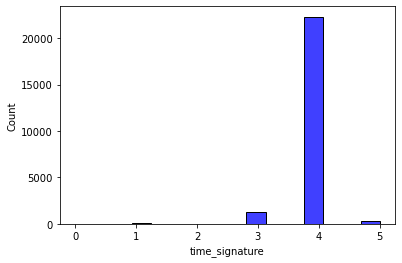

In [22]:
for column in check_techno_df.columns:
    sns.histplot(check_techno_df[column], kde=False,color='blue')
    plt.show()

In [23]:
techno=check_techno_df.describe()[1:3]
techno

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
mean,0.652463,0.718801,5.469212,-8.499862,0.565053,0.081947,0.156069,0.468071,0.177181,0.384523,125.403178,281995.919772,3.942670
std,0.154369,0.223249,3.627150,4.249885,0.495760,0.083464,0.266844,0.397102,0.153234,0.253457,21.078073,177278.519546,0.346644


## Reggae playlist

In [24]:
reggae_classics='https://open.spotify.com/playlist/37i9dQZF1DXbSbnqxMTGx9?si=62712ccb7ccc489b'
one_love='https://open.spotify.com/playlist/37i9dQZF1DWSiyIBdVQrkk?si=5469bd8ea38f4d10'
sunshine_reggae='https://open.spotify.com/playlist/37i9dQZF1DXbwoaqxaoAVr?si=fa12b7036d714f71'
vibra_tropical='https://open.spotify.com/playlist/37i9dQZF1DX3fXJqxGjuEP?si=a0d162f2bbf44ee8'
nacao_reggae='https://open.spotify.com/playlist/37i9dQZF1DWTMlvEhEJDRB?si=c59469aaff354cc8'
praiana='https://open.spotify.com/playlist/37i9dQZF1DX1AjDRHleN7v?si=ff9c5d1380df415d'
luau_jah='https://open.spotify.com/playlist/37i9dQZF1DWYkosMCdlEHA?si=2cc301ca1a784ab2'
fya='https://open.spotify.com/playlist/37i9dQZF1DX8TCaiq7EoZA?si=7652f4aa104b4cc2'

reggae_playlists=[reggae_classics,one_love,sunshine_reggae,vibra_tropical,nacao_reggae,praiana,luau_jah,fya]

In [25]:
reggae_df=get_data_from_list_playlists(reggae_playlists)

In [26]:
check_reggae_df=reggae_df.copy()
check_reggae_df=check_reggae_df.drop_duplicates(subset=['id'])
check_reggae_df=check_reggae_df.drop(['id','artist','song name'],axis=1)

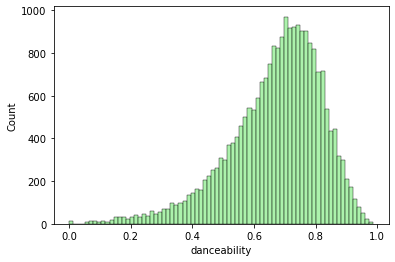

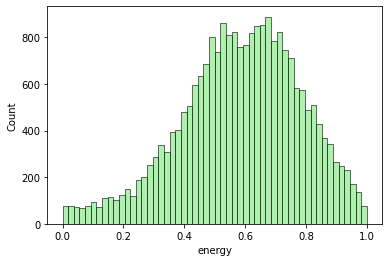

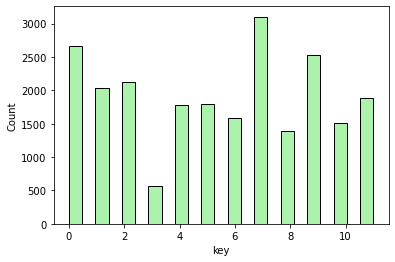

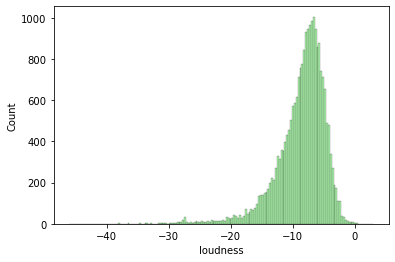

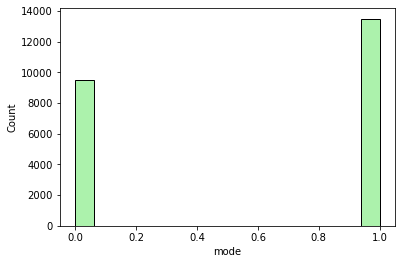

...

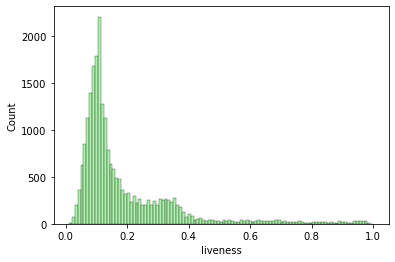

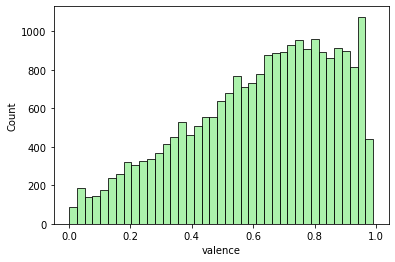

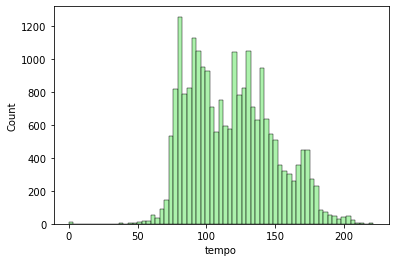

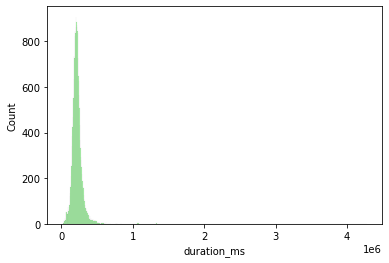

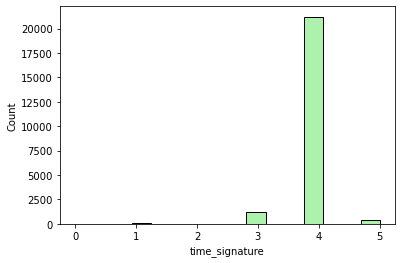

In [27]:
for column in check_reggae_df.columns:
    sns.histplot(check_reggae_df[column], kde=False,color='lightgreen')
    plt.show()

In [28]:
reggae=check_reggae_df.describe()[1:3]
reggae

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
mean,0.670687,0.583869,5.446167,-8.644310,0.587500,0.107013,0.304183,0.100768,0.187138,0.621618,118.264374,219264.707317,3.947169
std,0.150079,0.197546,3.554112,4.085346,0.492295,0.113058,0.286321,0.253342,0.162813,0.240488,30.571237,82408.204405,0.352384


## Hip Hop / Rap playlist

In [29]:
hiphop_rap_discoveries='https://open.spotify.com/playlist/37qJFLDWaNdUsXf1pZGoqT?si=c4bbebbc331b4bef'
hip_hop_rap_rnb='https://open.spotify.com/playlist/1hoiNExK21dVHpE3H30QtQ?si=31357c818c5449b6'
rapalion='https://open.spotify.com/playlist/3Xm45UFkkDlUGWtAd3HSCb?si=db93f139f0fc4b44'
hip_hop_rap_br='https://open.spotify.com/playlist/4CCXOPpFdQEGu4bx5jPL7o?si=da57b077ccee4734'
hip_hop_music='https://open.spotify.com/playlist/7iu7J3V0WPtm0GQIcZrOXp?si=7e44e6d75d5244cd'
rap_chileno='https://open.spotify.com/playlist/35wiko8UJbSj7BZYSABPLj?si=cddaa5e871a7474c'
rap_tuga_hits='https://open.spotify.com/playlist/37i9dQZF1DX5nVsobG0zBp?si=3cf0f2b170954f5a'

hip_hop_rap_playlists=[hiphop_rap_discoveries,hip_hop_rap_rnb,rapalion,
                       hip_hop_rap_br,hip_hop_music,rap_chileno,rap_tuga_hits]

In [30]:
hip_hop_df=get_data_from_list_playlists(hip_hop_rap_playlists)

In [31]:
check_hip_hop_df=hip_hop_df.copy()
check_hip_hop_df=check_hip_hop_df.drop_duplicates(subset=['id'])
check_hip_hop_df=check_hip_hop_df.drop(['id','artist','song name'],axis=1)

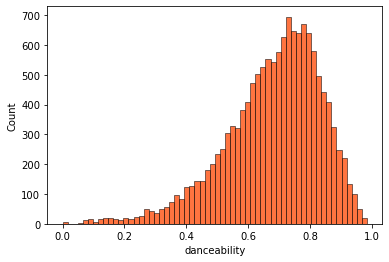

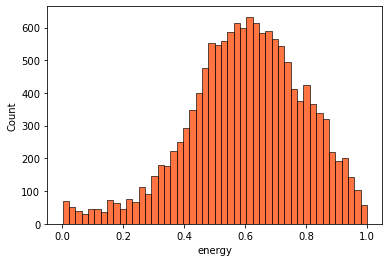

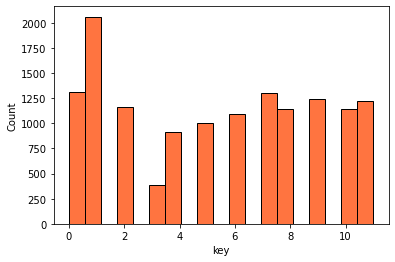

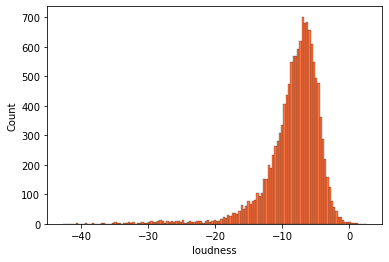

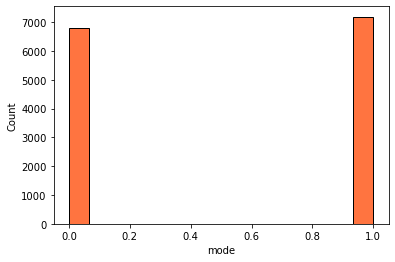

...

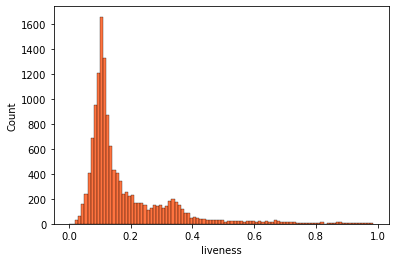

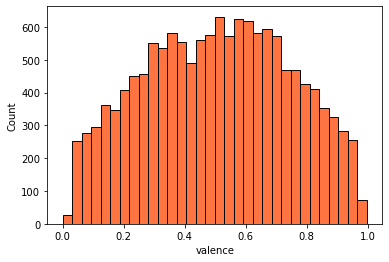

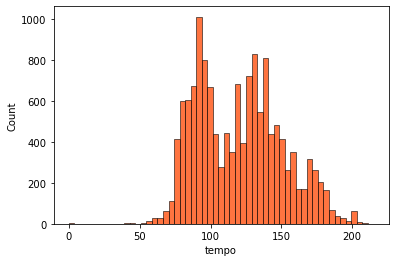

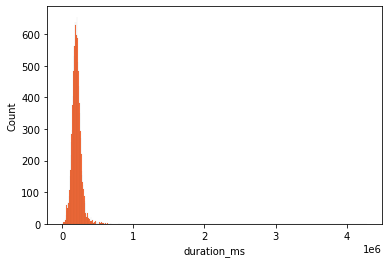

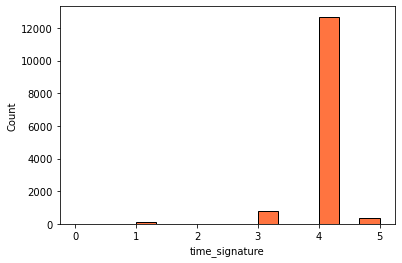

In [32]:
for column in check_hip_hop_df.columns:
    sns.histplot(check_hip_hop_df[column], kde=False,color='orangered')
    plt.show()

In [33]:
hip_hop=check_hip_hop_df.describe()[1:3]
hip_hop

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
mean,0.679977,0.601303,5.367201,-8.351050,0.514167,0.183631,0.270998,0.078708,0.183994,0.505791,120.118480,203428.136377,3.944691
std,0.154149,0.190913,3.644719,4.277125,0.499817,0.155261,0.266409,0.233559,0.147512,0.240003,30.314426,78522.751383,0.400558


## Metal playlists

In [34]:
metal_mix='https://open.spotify.com/playlist/37i9dQZF1EQpgT26jgbgRI?si=29dedcc1725a4076'
workout_metal='https://open.spotify.com/playlist/5SpXKOLINelm5Ivr5lUvj8?si=18f90730a0b541f7'
heavy_metal='https://open.spotify.com/playlist/37i9dQZF1DX9qNs32fujYe?si=498ff24acf3541b1'
metal_core='https://open.spotify.com/playlist/37i9dQZF1EIgtj4OvJCT7Q?si=71a1bfa7677840cd'
metal_charge='https://open.spotify.com/playlist/37i9dQZF1DX06VUQ1GoKge?si=e0afba6a607f4cb5'
metallica_radio='https://open.spotify.com/playlist/37i9dQZF1E4EBdeEVqipSd?si=3fae952dd4c4414c'
metal_my_vibe='https://open.spotify.com/playlist/0onnNXoMQoWeRFGrX3dJ4h?si=e0542c5091f04105'

metal_playlists=[metal_mix,workout_metal,heavy_metal,metal_core,metal_charge,metallica_radio,metal_my_vibe]

In [35]:
metal_df=get_data_from_list_playlists(metal_playlists)

In [36]:
check_metal_df=metal_df.copy()
check_metal_df=check_metal_df.drop_duplicates(subset=['id'])
check_metal_df=check_metal_df.drop(['id','artist','song name'],axis=1)

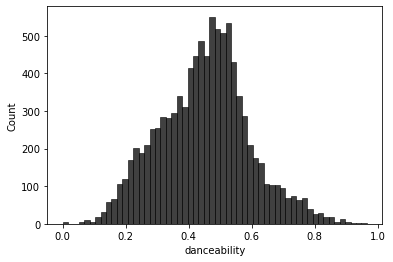

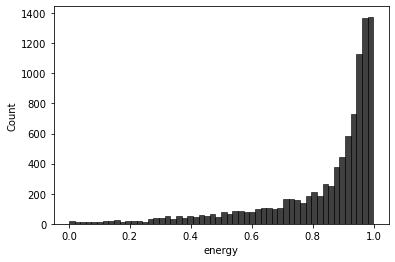

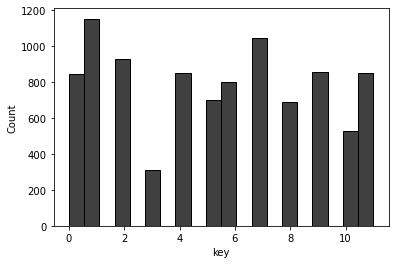

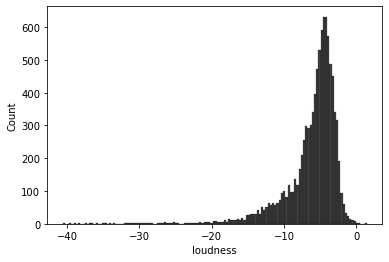

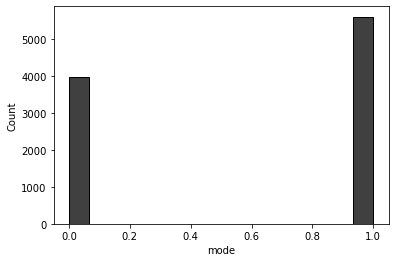

...

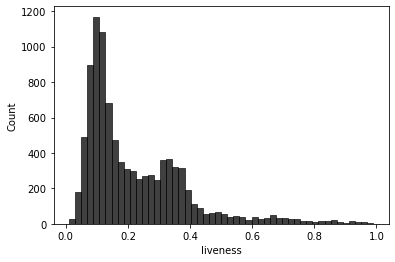

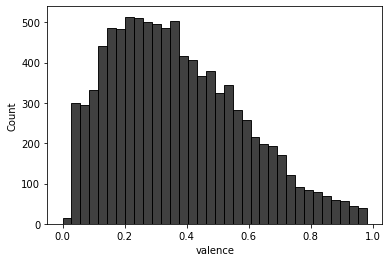

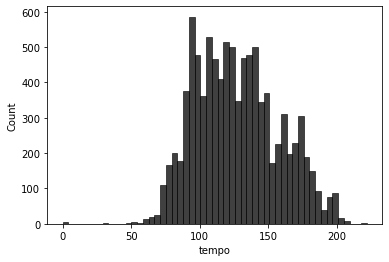

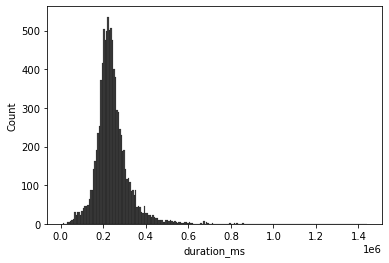

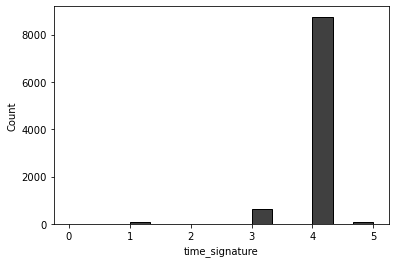

In [37]:
for column in check_metal_df.columns:
    sns.histplot(check_metal_df[column], kde=False,color='black')
    plt.show()

In [38]:
metal=check_metal_df.describe()[1:3]
metal

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
mean,0.449824,0.832464,5.314925,-6.144907,0.585713,0.093995,0.076817,0.132697,0.221328,0.370452,127.029918,241952.077712,3.915385
std,0.143069,0.200971,3.509353,3.762233,0.492624,0.071202,0.198504,0.264724,0.166659,0.210737,30.329316,82195.703064,0.390599


## Bossa Nova playlists

In [39]:
bossa_nova='https://open.spotify.com/playlist/37i9dQZF1DX4AyFl3yqHeK?si=6f4717b5dbab470c'
bossa_nova_melhores='https://open.spotify.com/playlist/3Sc6kxvtyqNunFxb2NByYa?si=0771200b30a047fa'
bossa_nova_jazz='https://open.spotify.com/playlist/37i9dQZF1EIcyFDXQX9B1P?si=14a7d5ec5fb846a4'
cafe_bossa='https://open.spotify.com/playlist/37i9dQZF1DX7ovYHwmjqZK?si=79d478a882964f4c'
bossanova_chill='https://open.spotify.com/playlist/0ZFtZMSBN1vD5A5pZaFLQW?si=896f4ab9b3904281'
bossa_nova_soft='https://open.spotify.com/playlist/741iZBK1cIMx5ufvj7H7gM?si=daa1d700ceff4756'
bossa_nova_covers='https://open.spotify.com/playlist/37i9dQZF1DXardnHdSkglX?si=ceb0092c300c4443'
bossa_nova_dinner='https://open.spotify.com/playlist/37i9dQZF1DWVleyMkaelTd?si=869648cd7bee4220'

bossa_nova_playlists=[bossa_nova,bossa_nova_melhores,bossa_nova_jazz,cafe_bossa,
                      bossanova_chill,bossa_nova_soft,bossa_nova_covers,bossa_nova_dinner]

In [40]:
bossa_nova_df=get_data_from_list_playlists(bossa_nova_playlists)

In [41]:
check_bossa_nova_df=bossa_nova_df.copy()
check_bossa_nova_df=check_bossa_nova_df.drop_duplicates(subset=['id'])
check_bossa_nova_df=check_bossa_nova_df.drop(['id','artist','song name'],axis=1)

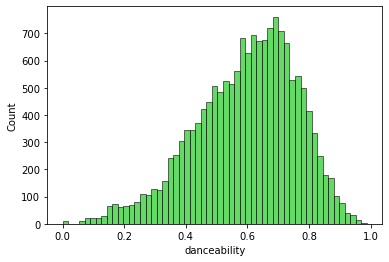

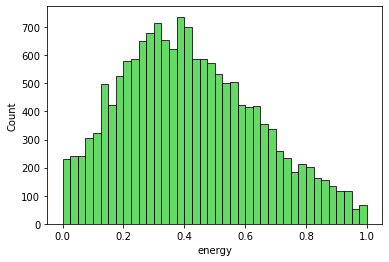

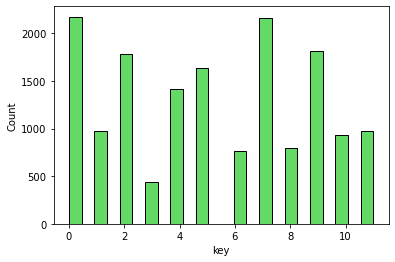

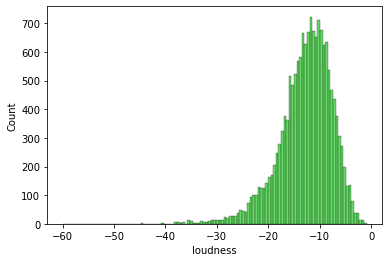

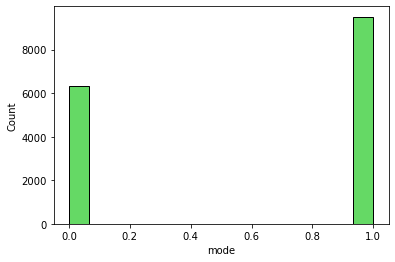

...

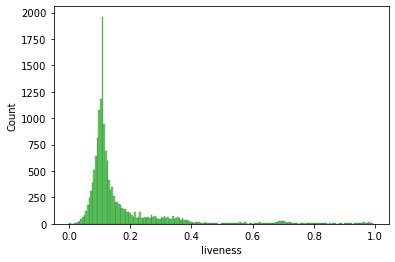

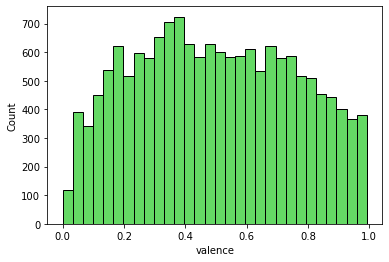

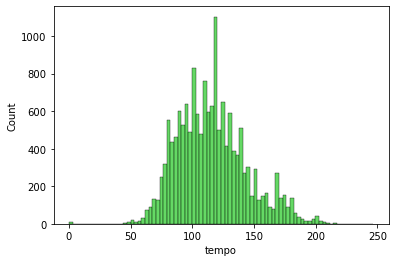

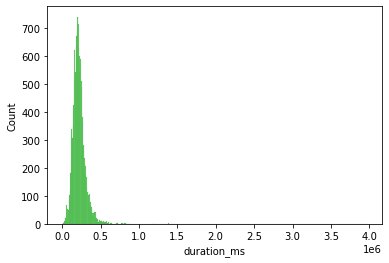

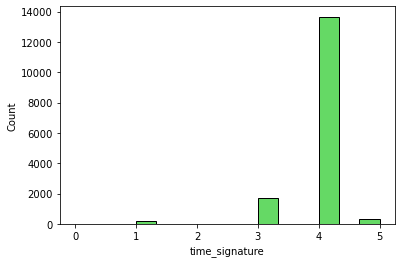

In [42]:
for column in check_bossa_nova_df.columns:
    sns.histplot(check_bossa_nova_df[column], kde=False,color='limegreen')
    plt.show()

In [43]:
bossa=check_bossa_nova_df.describe()[1:3]
bossa

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
mean,0.594537,0.417998,5.180189,-12.779826,0.600063,0.059756,0.602804,0.340756,0.167823,0.496778,115.955637,221751.781514,3.877539
std,0.164628,0.222381,3.486319,5.174208,0.489901,0.068651,0.314645,0.392607,0.147796,0.258287,28.056778,95556.796811,0.467865


### Concat all DataFrames

In [44]:
all_dfs=[test_df,rock_df,funk_df,techno_df,reggae_df,hip_hop_df,metal_df,bossa_nova_df]
final_df=pd.concat(all_dfs)

In [45]:
all_dfs_temp=[]
for df in all_dfs:
    df_temp = df.drop(columns=['id', 'artist', 'song name'])
    all_dfs_temp.append(df_temp)

In [46]:
print('Total number of songs:',final_df.shape)
print('Songs in duplicate:',n_repeated_songs(final_df))
if n_repeated_songs(final_df)!=0:
    final_df=final_df.drop_duplicates(subset=['id'])
print('New total number of songs:',final_df.shape)
print('Songs in duplicate:',n_repeated_songs(final_df))

Total number of songs: (238681, 16)
Songs in duplicate: 63618
New total number of songs: (175063, 16)
Songs in duplicate: 0


In [48]:
means=pd.concat([test,rock,funk,techno,reggae,hip_hop,metal,bossa],keys=['test','rock','funk','techno','reggae','hip_hop','metal','bossa nova'])
means

danceability    energy       key   loudness      mode  \
test       mean      0.606888  0.536201  5.305637  -9.024940  0.635190   
           std       0.155224  0.242999  3.571509   5.054075  0.481385   
rock       mean      0.524806  0.703217  5.302580  -7.223864  0.664654   
           std       0.162017  0.227607  3.580341   4.308307  0.472119   
funk       mean      0.630004  0.619800  5.325335  -9.101874  0.578277   
           std       0.162582  0.216315  3.622019   4.241340  0.493841   
techno     mean      0.652463  0.718801  5.469212  -8.499862  0.565053   
           std       0.154369  0.223249  3.627150   4.249885  0.495760   
reggae     mean      0.670687  0.583869  5.446167  -8.644310  0.587500   
           std       0.150079  0.197546  3.554112   4.085346  0.492295   
hip_hop    mean      0.679977  0.601303  5.367201  -8.351050  0.514167   
           std       0.154149  0.190913  3.644719   4.277125  0.499817   
metal      mean      0.449824  0.832464  5.314925  -6.144907  0.585713   
           std       0.143069  0.200971  3.509353   3.762233  0.492624   
bossa nova mean      0.594537  0.417998  5.180189 -12.779826  0.600063   
           std       0.164628  0.222381  3.486319   5.174208  0.489901   

                 speechiness  acousticness  instrumentalness  liveness  \
test       mean     0.084474      0.393102          0.212528  0.169149   
           std      0.090024      0.336764          0.357821  0.133338   
rock       mean     0.082317      0.176677          0.123947  0.204652   
           std      0.088024      0.273304          0.269491  0.160571   
funk       mean     0.090687      0.283556          0.219715  0.192777   
           std      0.108941      0.294237          0.341000  0.175700   
techno     mean     0.081947      0.156069          0.468071  0.177181   
           std      0.083464      0.266844          0.397102  0.153234   
reggae     mean     0.107013      0.304183          0.100768  0.187138   
           std      0.113058      0.286321          0.253342  0.162813   
hip_hop    mean     0.183631      0.270998          0.078708  0.183994   
           std      0.155261      0.266409          0.233559  0.147512   
metal      mean     0.093995      0.076817          0.132697  0.221328   
           std      0.071202      0.198504          0.264724  0.166659   
bossa nova mean     0.059756      0.602804          0.340756  0.167823   
           std      0.068651      0.314645          0.392607  0.147796   

                  valence       tempo    duration_ms  time_signature  
test       mean  0.442149  117.916029  199191.149466        3.908406  
           std   0.242592   31.364581   76622.723010        0.422699  
rock       mean  0.453891  126.384933  208624.146969        3.927013  
           std   0.229686   30.631364   79445.056354        0.368728  
funk       mean  0.582515  117.956925  243232.191380        3.925109  
           std   0.258123   26.501294  111249.871672        0.365977  
techno     mean  0.384523  125.403178  281995.919772        3.942670  
           std   0.253457   21.078073  177278.519546        0.346644  
reggae     mean  0.621618  118.264374  219264.707317        3.947169  
           std   0.240488   30.571237   82408.204405        0.352384  
hip_hop    mean  0.505791  120.118480  203428.136377        3.944691  
           std   0.240003   30.314426   78522.751383        0.400558  
metal      mean  0.370452  127.029918  241952.077712        3.915385  
           std   0.210737   30.329316   82195.703064        0.390599  
bossa nova mean  0.496778  115.955637  221751.781514        3.877539  
           std   0.258287   28.056778   95556.796811        0.467865

# <center> CLUSTERING

In [51]:
data=final_df.copy()
data=data.sample(frac=0.2,random_state=42)
data=data.drop(['id','artist','song name','loudness','mode','duration_ms','time_signature'],axis=1)
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)

In [52]:
len(data.columns)

9

In [53]:
K=range(2,20)
ssq = []
silhouette = []
calinski_harabasz = []

for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(data)
    
    ssq.append(kmeans.inertia_)
    silhouette.append(silhouette_score(data, kmeans.labels_))
    calinski_harabasz.append(calinski_harabasz_score(data, kmeans.labels_))

Text(0.5, 1.0, 'Elbow Method')

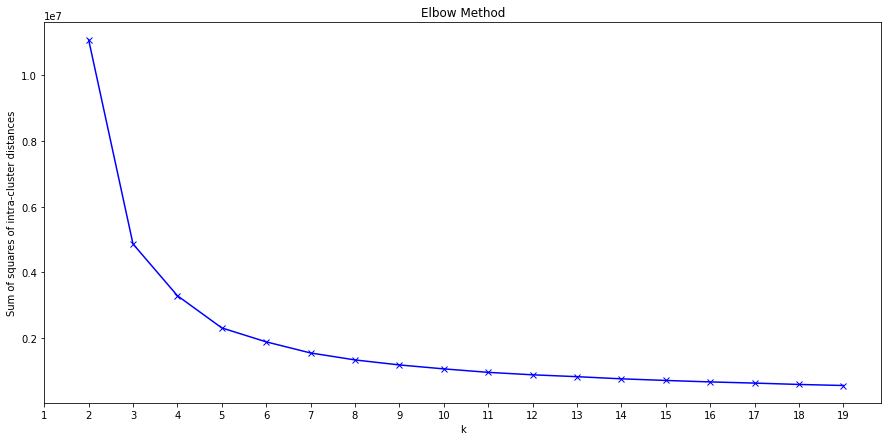

In [54]:
plt.figure(figsize=(15,7))
plt.plot(range(2, 20), ssq, 'bx-')
plt.xlabel('k')
plt.xticks(range(1, 20))
plt.ylabel('Sum of squares of intra-cluster distances')
plt.title('Elbow Method')

Text(0.5, 1.0, 'Silhouette Method')

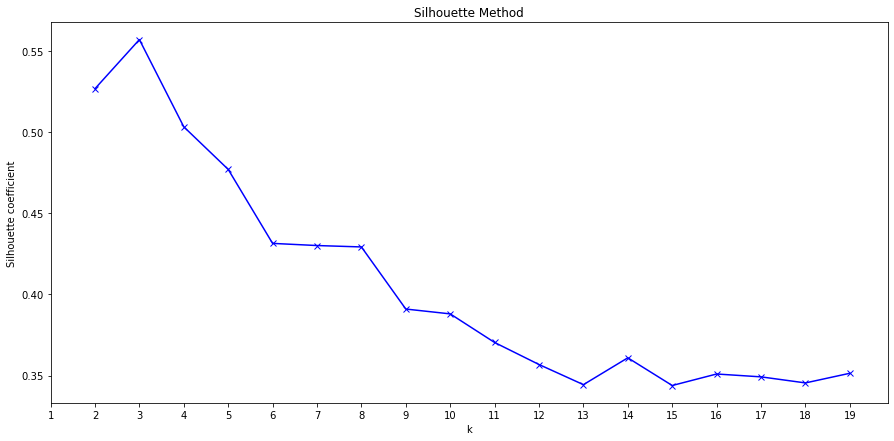

In [55]:
plt.figure(figsize=(15,7))
plt.plot(K, silhouette, 'bx-')
plt.xlabel('k')
plt.xticks(range(1, 20))
plt.ylabel('Silhouette coefficient')
plt.title('Silhouette Method')

Text(0.5, 1.0, 'Calinski-Harabasz Method')

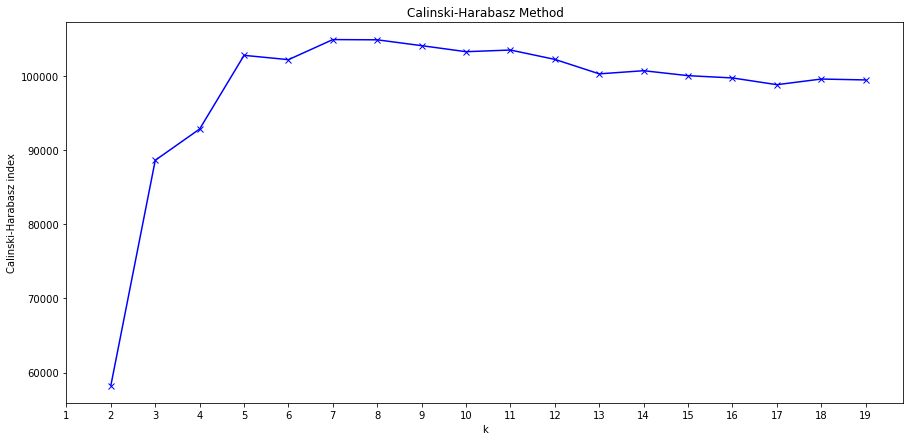

In [56]:
plt.figure(figsize=(15,7))
plt.plot(range(2, 20), calinski_harabasz, 'bx-')
plt.xlabel('k')
plt.xticks(range(1, 20))
plt.ylabel('Calinski-Harabasz index')
plt.title('Calinski-Harabasz Method')

We've set the clusters numbers to 8.

# <center> Visualizing the clusters

In [263]:
data=final_df.copy()
data=data.sample(frac=0.2,random_state=42)
data=data.drop(['id','artist','song name','loudness','mode','duration_ms','time_signature'],axis=1)
scaler=MinMaxScaler()
data_prep=scaler.fit_transform(data)
pca=PCA(3) 
data_3D=pca.fit_transform(data_prep)

kmeans=KMeans(n_clusters=8, random_state=42)
kmeans.fit(data_scaled)

clusters=kmeans.predict(data_scaled)

data['cluster']=clusters.tolist()

fig = px.scatter_3d(data, x=data_3D[:, 0], y=data_3D[:, 1], z=data_3D[:, 2], color='cluster', opacity=0.05)
fig.show()

In [278]:
data=final_df.copy()
data=data.drop(['id','artist','song name','loudness','mode','duration_ms','time_signature'],axis=1)
scaler=MinMaxScaler()
data_prep=scaler.fit_transform(data)
pca=PCA(3) 
data_3D=pca.fit_transform(data_prep)

kmeans=KMeans(n_clusters=8, random_state=42)
kmeans.fit(data_prep)

clusters=kmeans.predict(data_prep)

data['cluster']=clusters.tolist()

fig = px.scatter_3d(data, x=data_3D[:, 0], y=data_3D[:, 1], z=data_3D[:, 2], color='cluster', opacity=0.05)
fig.show()

In [295]:
final=pd.concat([final_df,data['cluster']],axis=1)

# <center> Getting the 100 HOT songs

In [93]:
link='https://www.billboard.com/charts/hot-100/'
r=rq.get(link)
status=r.status_code
status

200

In [94]:
html=r.content
soup=BeautifulSoup(html,'html.parser')
soup.prettify();

In [95]:
html_chart=soup.find('div',attrs={'class':'chart-results-list'})

In [440]:
artists=[]
iteration=0
for i in range(len(html_chart.find_all('span',attrs={'class':'c-label'}))):
    iteration+=1
    output=html_chart.find_all('span',attrs={'class':'c-label'})[i].get_text(strip=True)
    if output=='NEW' or output=='RE-\nENTRY':
        iteration-=1
    if iteration%8==2:
        artists.append(output.lower())

In [441]:
titles=[]
iteration=0
for i in range(len(html_chart.find_all('h3',attrs={'class':'c-title'}))):
    iteration+=1
    output=html_chart.find_all('h3',attrs={'class':'c-title'})[i].get_text(strip=True)
    if iteration%4==3:
        titles.append(output.lower())

In [442]:
chart=pd.DataFrame({'place_on_chart':range(1,101),'artist': artists,'song': titles,}).set_index('place_on_chart')
chart

,artist,song
place_on_chart,,
1,the weeknd & ariana grande,die for you
2,miley cyrus,flowers
3,sza,kill bill
4,pinkpantheress & ice spice,"boy's a liar, pt. 2"
5,morgan wallen,last night
...,...,...
96,karol g,besties
97,yandel & feid,yandel 150
98,karol g & carla morrison,manana sera bonito


# <center> Putting it all together

In [464]:
def spotify():
    user_song=input('Introduce a song of an artist to get a similar song.\n Use the format: artist- song.\n Type here:')
    [artist,song]=user_song.split('- ')
    artist=artist.lower()
    song=song.lower()
    if chart.loc[chart['artist'].isin([artist]) & chart['song'].isin([song]), 'song'].any():
        use_song=chart.sample()
        artist=use_song['artist'].values[0].replace('_',' ').title()
        song=use_song['song'].values[0].replace('_',' ').title()
        return print('Recommended song:',artist,'-',song)
    else:
        result = sp.search(q='artist:' + artist + ' track:' + song, type='track')
        track_id = result['tracks']['items'][0]['id']
        features = sp.audio_features([track_id])
        track_features = pd.DataFrame.from_dict(features[0],orient='index').T
        track_features=track_features.drop(['loudness','mode','duration_ms',
                                            'time_signature','type','uri','track_href','analysis_url','id'],axis=1)
        scaler=MinMaxScaler()
        track_features_prep=scaler.fit_transform(track_features)
        cluster=kmeans.predict(track_features_prep)

        songs_in_cluster=final.query("cluster == @cluster")
        random_song=songs_in_cluster.sample()
        artist=random_song['artist'].values[0].replace('_',' ').title()
        song=random_song['song name'].values[0].replace('_',' ').title()
        return print('Recommended song:',artist,'-',song)



# <center> Running the Song Recommender

In [ ]:
spotify()